In [ ]:
import anndata as ad
import numpy as np
import pandas as pd
import novaice
import scanpy as sc

In [ ]:
counts = pd.read_csv(
    "./MCE_Bioactive_Compounds_MDA_MB_231_10μM_Counts.csv", skiprows=[0], index_col=0
)
counts

,A2M,A4GNT,AARS,ABCA1,ABCB1,ABCB6,ABCC5,ABCC8,ABCF1,ABCF3,...,ZNF185,ZNF274,ZNF281,ZNF318,ZNF395,ZNF451,ZNF586,ZNF589,ZW10,ZYX
Sample_id,,,,,,,,,,,,,,,,,,,,,
MCE1_231_24H_X1:D10,1,0,9,1,0,0,0,0,14,0,...,0,1,0,6,0,9,2,2,3,1
MCE1_231_24H_X1:G14,1,0,17,0,0,0,0,0,3,0,...,0,1,0,1,1,7,1,0,0,1
MCE1_231_24H_X1:G22,0,0,7,0,0,0,1,0,8,1,...,0,1,0,4,0,11,2,2,0,2
MCE1_231_24H_X1:O22,0,0,8,0,0,0,2,0,9,1,...,1,4,0,7,0,14,3,1,0,3
MCE1_231_24H_X1:G08,0,0,13,0,0,0,0,0,7,0,...,0,2,0,7,0,11,1,1,0,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
MCE7_231_24H_X3:P01,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
MCE7_231_24H_X3:L21,0,0,8,0,0,0,2,0,7,1,...,0,2,0,5,0,27,1,2,1,2
MCE7_231_24H_X3:P13,0,0,9,0,0,1,3,0,3,0,...,0,1,0,6,0,24,2,1,0,0


In [ ]:
metadata = pd.read_excel(
    "./MCE_Bioactive_Compounds_MDA_MB_231_10μM_MetaData.xlsx", skiprows=[0]
)
metadata

,unique_ID,experiment_no,sample_plate,sample_row,sample_column,cell_id,pert_itime,pert_idose,sample,treatment
0,MCE1_231_24H_X1:D10,MCE_20221009,MCE1_231_24H_X1,4,10,cell_231,24 h,10.0 uM,HY_100833,HY_100833
1,MCE1_231_24H_X1:G14,MCE_20221009,MCE1_231_24H_X1,7,14,cell_231,24 h,10.0 uM,HY_100395,HY_100395
2,MCE1_231_24H_X1:G22,MCE_20221009,MCE1_231_24H_X1,7,22,cell_231,24 h,10.0 uM,HY_100409,HY_100409
3,MCE1_231_24H_X1:O22,MCE_20221009,MCE1_231_24H_X1,15,22,cell_231,24 h,10.0 uM,HY_100383,HY_100383
4,MCE1_231_24H_X1:G08,MCE_20221009,MCE1_231_24H_X1,7,8,cell_231,24 h,10.0 uM,HY_100399A,HY_100399A
...,...,...,...,...,...,...,...,...,...,...
40866,MCE7_231_24H_X3:P01,MCE_20221230_3,MCE7_231_24H_X3,16,1,cell_231,24 h,-666,Blank_42,Blank
40867,MCE7_231_24H_X3:L21,MCE_20221230_3,MCE7_231_24H_X3,12,21,cell_231,24 h,10.0 uM,HY_N0288,HY_N0288
40868,MCE7_231_24H_X3:P13,MCE_20221230_3,MCE7_231_24H_X3,16,13,cell_231,24 h,10.0 uM,HY_N0316,HY_N0316
40869,MCE7_231_24H_X3:J23,MCE_20221230_3,MCE7_231_24H_X3,10,23,cell_231,24 h,-666,DMSO_02,DMSO


In [ ]:
adata = ad.AnnData(
    X=counts.values,
    obs=metadata,
    var=counts.columns.to_frame(index=True)
    .rename_axis(index=None)
    .rename(columns={0: "gene_name"}),
)

adata

/Users/lucas-diedrich/mamba/envs/hackathon/lib/python3.12/functools.py:912: ImplicitModificationWarning: Transforming to str index.
  return dispatch(args[0].__class__)(*args, **kw)


AnnData object with n_obs × n_vars = 40871 × 3407
    obs: 'unique_ID', 'experiment_no', 'sample_plate', 'sample_row', 'sample_column', 'cell_id', 'pert_itime', 'pert_idose', 'sample', 'treatment'
    var: 'gene_name'

In [ ]:
compound_metadata = pd.read_csv(
    "/Users/lucas-diedrich/Documents/Programming/nucleate-hackathon/nucleate-hackathon-2025/preprocessing/dataset-1/cas-to-smiles/compounds.csv"
)
compound_metadata

,Ranking,Catalog Number,Score,Compound name,Treatment concentration,CAS Number
0,1,HY_107369,0.367344,4-Butylresorcinol,10 μM,18979-61-8
1,2,HY_119674A,0.366090,Xanthopterin (hydrate),10 μM,5979-01-1
2,3,HY_19747,0.345520,HPOB,10 μM,1429651-50-2
3,4,HY_114177,0.339016,PF-06873600,10 μM,2185857-97-8
4,5,HY_105917,0.336668,Endovion,10 μM,265646-85-3
...,...,...,...,...,...,...
12350,12351,HY_136250,-0.274049,BSJ-03-204,10 μM,2349356-09-6
12351,12352,HY_138694,-0.275973,5-Benzyloxygramine,10 μM,1453-97-0
12352,12353,HY_10716A,-0.276133,PF-03463275,10 μM,1173239-39-8
12353,12354,HY_13515,-0.277132,Sirtinol,10 μM,410536-97-9


In [ ]:
compound_mapping = pd.read_csv(
    "/Users/lucas-diedrich/Documents/Programming/nucleate-hackathon/nucleate-hackathon-2025/preprocessing/dataset-1/cas-to-smiles/CAS_to_smiles.tsv",
    sep="\t",
    index_col=0,
)
compound_mapping

,CID,CAS,smiles
0,2,5080-50-2,CC(=O)OC(CC(=O)O)C[N+](C)(C)C
1,7,2715-68-6,CCN1C=NC2=C(N=CN=C21)N
2,19,303-38-8,C1=CC(=C(C(=C1)O)O)C(=O)O
3,43,103404-90-6,C(CC(=O)O)C(C(=O)O)O
4,47,1460-34-0,CCC(C)C(=O)C(=O)O
...,...,...,...
45831,176541418,474-25-9,C[C@H](CCC(=O)O)[C@H]1CCC2[C@@]1(CC[C@@H]3[C@@...
45832,176542861,13292-46-1,C[C@H]1/C=C(/C=C(/C(=O)NC2=C(C(=C3C(=C2O)C(=C(...
45833,176544248,129-16-8,C1=CC=C2C(=C1)C(=O)OC23C4=CC(=C(C=C4OC5=C=C([C...
45834,176546160,3810-74-0,C[C@@H]1[C@]([C@@H]([C@H](O1)O[C@@H]2[C@H]([C@...


In [ ]:
compound_metadata_annotated = (
    pd.merge(
        compound_metadata,
        compound_mapping,
        left_on="CAS Number",
        right_on="CAS",
        how="inner",
    )
    .drop_duplicates(["CAS Number", "Catalog Number"])
    .drop(
        columns=[
            "Score",
            "Treatment concentration",
        ]
    )
)
compound_metadata_annotated

,Ranking,Catalog Number,Compound name,CAS Number,CID,CAS,smiles
0,1,HY_107369,4-Butylresorcinol,18979-61-8,205912,18979-61-8,CCCCC1=C(C=C(C=C1)O)O
1,2,HY_119674A,Xanthopterin (hydrate),5979-01-1,261738,5979-01-1,C1=CC=C(C=C1)C(C2=CC=CC=C2)(C3=CC=CC=C3)OCC4C(...
9,3,HY_19747,HPOB,1429651-50-2,71532921,1429651-50-2,C1=CC=C(C=C1)N(CCO)C(=O)CC2=CC=C(C=C2)C(=O)NO
10,4,HY_114177,PF-06873600,2185857-97-8,134247638,2185857-97-8,C[C@]1(CCC[C@H]1N2C3=NC(=NC=C3C=C(C2=O)C(F)F)N...
13,5,HY_105917,Endovion,265646-85-3,10005966,265646-85-3,C1=CC(=C(C=C1Br)C2=NNN=N2)NC(=O)NC3=CC(=CC(=C3...
...,...,...,...,...,...,...,...
49721,12351,HY_136250,BSJ-03-204,2349356-09-6,137628658,2349356-09-6,CC1=C(C(=O)N(C2=NC(=NC=C12)NC3=NC=C(C=C3)N4CCN...
49723,12352,HY_138694,5-Benzyloxygramine,1453-97-0,73814,1453-97-0,CN(C)CC1=CNC2=C1C=C(C=C2)OCC3=CC=CC=C3
49726,12353,HY_10716A,PF-03463275,1173239-39-8,44156901,1173239-39-8,CN1C[C@@H]2[C@H](C1)C2CN(CC3=CC(=C(C=C3)F)Cl)C...
49728,12354,HY_13515,Sirtinol,410536-97-9,1376645,410536-97-9,C[C@@H](C1=CC=CC=C1)NC(=O)C2=CC=CC=C2N=CC3=C(C...


In [ ]:
adata.obs = adata.obs.merge(
    compound_metadata_annotated,
    left_on="treatment",
    right_on="Catalog Number",
    how="left",
)

/Users/lucas-diedrich/mamba/envs/hackathon/lib/python3.12/functools.py:912: ImplicitModificationWarning: Transforming to str index.
  return dispatch(args[0].__class__)(*args, **kw)


In [ ]:
novaice.pp.foundation_model_embeddings(
    adata,
    smiles_col="smiles",
    model_name="ibm-research/MoLFormer-XL-both-10pct",
    device="cpu",
)

In [ ]:
novaice.pp.morgan_fingerprints(
    adata,
    smiles_col="smiles",
)

[11:22:16] DEPRECATION WARNING: please use MorganGenerator
[11:22:16] DEPRECATION WARNING: please use MorganGenerator
[11:22:16] DEPRECATION WARNING: please use MorganGenerator
[11:22:16] DEPRECATION WARNING: please use MorganGenerator
[11:22:16] DEPRECATION WARNING: please use MorganGenerator
[11:22:16] DEPRECATION WARNING: please use MorganGenerator
[11:22:16] DEPRECATION WARNING: please use MorganGenerator
[11:22:16] DEPRECATION WARNING: please use MorganGenerator
[11:22:16] DEPRECATION WARNING: please use MorganGenerator
[11:22:16] DEPRECATION WARNING: please use MorganGenerator
[11:22:16] DEPRECATION WARNING: please use MorganGenerator
[11:22:16] DEPRECATION WARNING: please use MorganGenerator
[11:22:16] DEPRECATION WARNING: please use MorganGenerator
[11:22:16] DEPRECATION WARNING: please use MorganGenerator
[11:22:16] DEPRECATION WARNING: please use MorganGenerator
[11:22:16] DEPRECATION WARNING: please use MorganGenerator
[11:22:16] DEPRECATION WARNING: please use MorganGenerat

In [ ]:
adata.layers["counts"] = adata.X.copy()

In [ ]:
sc.pp.normalize_total(adata, target_sum=1e6)
sc.pp.log1p(adata)

In [ ]:
sc.pp.pca(adata)

In [ ]:
sc.pp.neighbors(adata)

huggingface/tokenizers: The current process just got forked, after parallelism has already been used. Disabling parallelism to avoid deadlocks...
To disable this warning, you can either:
	- Avoid using `tokenizers` before the fork if possible
	- Explicitly set the environment variable TOKENIZERS_PARALLELISM=(true | false)


In [ ]:
sc.tl.umap(adata, random_state=42)

In [ ]:
def assign_sample_type(sample):
    if "Blank" in sample:
        return "Blank"
    elif "DMSO" in sample:
        return "DMSO"
    elif "HY" in sample:
        return "compound"
    else:
        return np.nan


def assign_sample(sample):
    if "Blank" in sample:
        return "Blank"
    elif "DMSO" in sample:
        return "DMSO"
    elif "HY" in sample:
        return sample
    else:
        return np.nan


adata.obs["sample_type"] = adata.obs["sample"].apply(assign_sample_type)
adata.obs["sample_streamlined"] = adata.obs["sample"].apply(assign_sample)

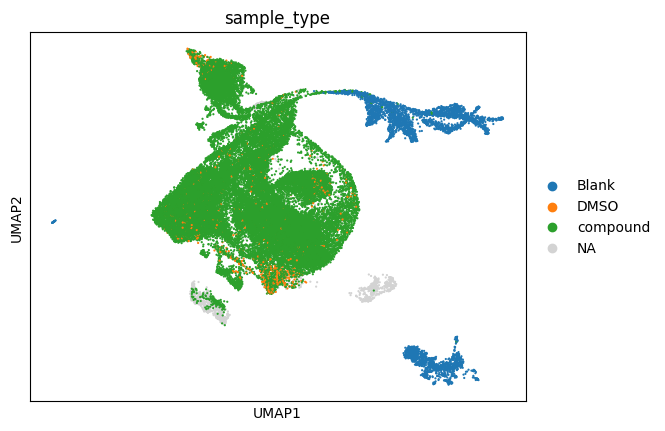

In [ ]:
sc.pl.umap(adata, color="sample_type", size=10)

In [ ]:
sc.tl.rank_genes_groups(adata, groupby="sample_streamlined", reference="DMSO")

/Users/lucas-diedrich/mamba/envs/hackathon/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:458: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "names"] = self.var_names[global_indices]
/Users/lucas-diedrich/mamba/envs/hackathon/lib/python3.12/site-packages/scanpy/tools/_rank_genes_groups.py:460: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  self.stats[group_name, "scores"] = scores[global_indices]
/Users/lucas-diedrich/mamba/envs/hackathon/lib/python3.12/site-packages/scanpy/tools/_rank_gene

In [ ]:
deg = sc.get.rank_genes_groups_df(adata, group=None)
deg

,group,names,scores,logfoldchanges,pvals,pvals_adj
0,Blank,TGFBI,0.315402,0.387819,7.524835e-01,7.535895e-01
1,Blank,CA4,0.000000,0.000000,1.000000e+00,1.000000e+00
2,Blank,PLA2G2A,0.000000,0.000000,1.000000e+00,1.000000e+00
3,Blank,SHH,0.000000,0.000000,1.000000e+00,1.000000e+00
4,Blank,ST8SIA6,0.000000,0.000000,1.000000e+00,1.000000e+00
...,...,...,...,...,...,...
38693294,HY_Z0816,PDK1,-32.811218,-32.265202,6.374044e-154,4.343273e-151
38693295,HY_Z0816,CD86,-32.823532,-32.308300,5.324195e-154,4.343273e-151
38693296,HY_Z0816,IGFBP5,-33.353111,-32.288464,2.337561e-157,2.654690e-154
38693297,HY_Z0816,XCL2,-34.503044,-32.386608,1.266685e-164,2.157798e-161


In [ ]:
deg.to_parquet("./MCE_Bioactive_Compounds_HEK293T_10μM.deg.parquet")

In [ ]:
del adata.uns["rank_genes_groups"]

In [ ]:
adata.obs["pert_idose"] = adata.obs["pert_idose"].astype(str)

In [ ]:
adata.write_h5ad("./MCE_Bioactive_Compounds_MDA_MB_231_10μM.h5ad")